# Ocean Flow simulation 

## Introduction

The Philippine Archipelago is a fascinating multiscale ocean region. Its geometry is complex, with multiple straits, islands, steep shelf-breaks, and coastal features, leading to partially interconnected seas and basins. In this project, I will be studying, understanding, and navigating through the ocean current flows.  

The data set consists of the ocean flow vectors for time $T$ from 1 to 100. The flow in the data set is an averaged flow from the surface to either near the bottom or 400m of depth, whichever is shallower. It is thus a 2D vector field. The files *u.csv contain the horizontal components of the vectors, while the files *v.csv contain the vertical component. The numbers in the file names indicate the time. For instance, files 24u.csv and 24v.csv contain the information of the flow at time index 23 for **zero-indexed** arrays (Python) or time index  for one-indexed array (Matlab). The file mask.csv, if needed, contains a 0-1 matrix identifying land and water.  

**Additional information and units**

The data were collected in January 2009. Flows are given in kilometers per hour (km/h) units. The time interval between the data snapshots is 3hrs. The first time index (0 for zero-indexed,  1 for one-indexed) will correspond in these problems to the time coordinate of 0 hrs. Thus, for example, 1u.csv gives data at a time coordinate of 0 hours.

The grid spacing used is 3 km. The matrix index (0,0) will correspond in these problems to the coordinate (0km, 0km), or the **bottom, left** of the plot. For simplicity, we will not be using longitudes and latitudes in this problem.

The columns of the .csv files correspond to the horizontal direction (x-axis), the rows of the .csv files correspond to the vertical direction (y-axis).

## Import libraries and load data

In [1]:
# import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sn
import matplotlib as mpl
mpl.rcParams.update({'figure.max_open_warning': 0})
%matplotlib widget

In [2]:
# read the mask data which defines the land and ocean
folder = "data/"
mask = pd.read_csv(folder + "mask.csv", header = None)

In [3]:
# read the flow data and do some calculations
us = []
vs = []
for i in range(100):
    us.append(pd.read_csv(folder + str(i+1)+"u.csv", header=None).to_numpy())
    vs.append(pd.read_csv(folder + str(i+1)+"v.csv", header=None).to_numpy())

us = np.array(us)
vs = np.array(vs)
flow_speed = np.sqrt(us**2 + vs**2)

## Get familiar with the data

A mask matrix is provided to define the regions of land and sea. The elements of this matrix are zero or one. Land area is represented by zero and sea by one.

In [4]:
# check the shape of the matrix
mask.shape

(504, 555)

Plot the map of this area.

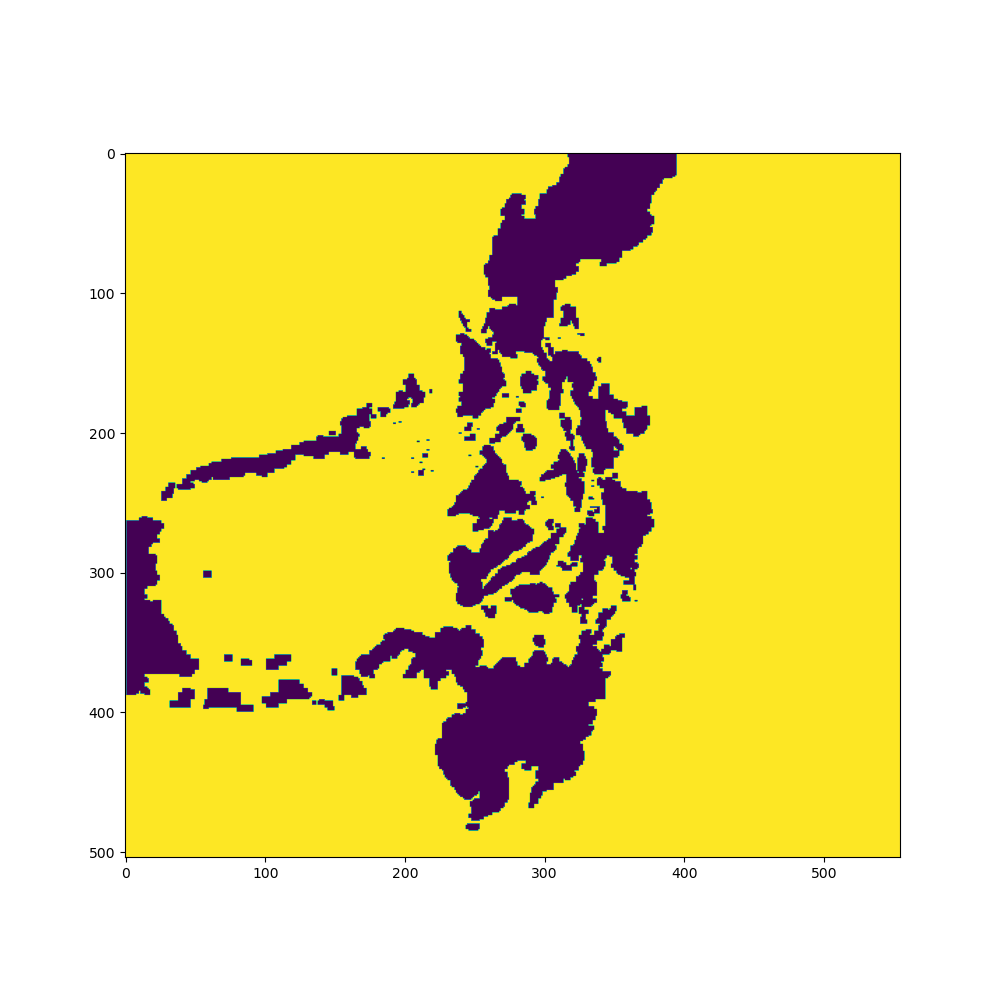

In [5]:
fig = plt.figure(figsize=(10, 10))
plt.imshow(mask)
plt.show()

In the figure above, purple shows the land and yellow shows the ocean.  

Ocean flow speed is represented by vectors. np.array us stores the horizontal components of the vectors and vs stores the vertical components.

In [6]:
# check the shape of the matrix
us.shape, vs.shape

((100, 504, 555), (100, 504, 555))

These are 3-dimensional matrices. The first dimension represents the time coordinate, second dimension represents x-axis and third dimension represents y-axis.

**Descriptive statistics for flow speed**

In [7]:
# calculate the variance of flow speed at each point
speed_var = flow_speed.var(axis = 0)
speed_var.shape

(504, 555)

In [8]:
# find the minimum variance of speed flow. Land area has variance of 0, and therefore is not included in the calculation
speed_var_min = speed_var[speed_var != 0].min()
print(f"Mininum variance of flow speed is {speed_var_min}")

print("The location is")
# find the index of minimum variance data
np.where(speed_var == speed_var_min)


Mininum variance of flow speed is 1.2297629738694259e-13
The location is


(array([121]), array([170]))

In [9]:
# what is the average flow speed? I want to get some idea about how far a particle can move in a certain amount of time.

print(f'the average flow speed is {flow_speed[flow_speed != 0].mean()} km/h')

the average flow speed is 0.534775063012957 km/h


In [10]:
# find the location and timestamp of a point where the flow has maximum x-axis velocity
u_max = np.amax(us)
np.where(us == u_max)

(array([28]), array([181]), array([347]))

In [11]:
# overall average velocity on x-axis and y-axis
print("average velocity on the x-axis and y-axis is")
np.mean(us), np.mean(vs)

average velocity on the x-axis and y-axis is


(-0.09366228934616833, -0.03548388738810676)

## Visualization of ocean flow

In [12]:
# the original mask matrix is inverted. Here I inverted it back 
mask_invert = mask.values[::-1]

In [13]:
# this function returns the points and the flow velocity at these points for drawing the arrows on the map
def get_quiver_params(time_index=0, distance=10, us=us, vs=vs):
    """
    This function returns parameters for drawing arrows on the map
    
    Params:
        time_index: int, time index
        distance: int, this is how far away the points are sampled for drawing the arrows
        us: np.array, it is the array for x-axis velocity
        vs: np.array, it is the array for y-axis velocity
    
    Return:
        X, Y define the arrow locations
        U, V define the arrow directions
        C sets the color
    """
    X = []
    Y = []
    U = []
    V = []
    C = []
    #loop through the rows
    for i in range(0, 504, distance):
        #loop through the columns
        for j in range(0, 555, distance):
            if mask_invert[i, j] == 1:
                X.append(j)
                Y.append(i)
                U.append(us[time_index,i,j])
                V.append(vs[time_index,i,j])
                C.append(np.sqrt(us[time_index,i,j]**2 + vs[time_index,i,j]**2))
    return X, Y, U, V, C

**Creat a function to plot the ocean flow.**

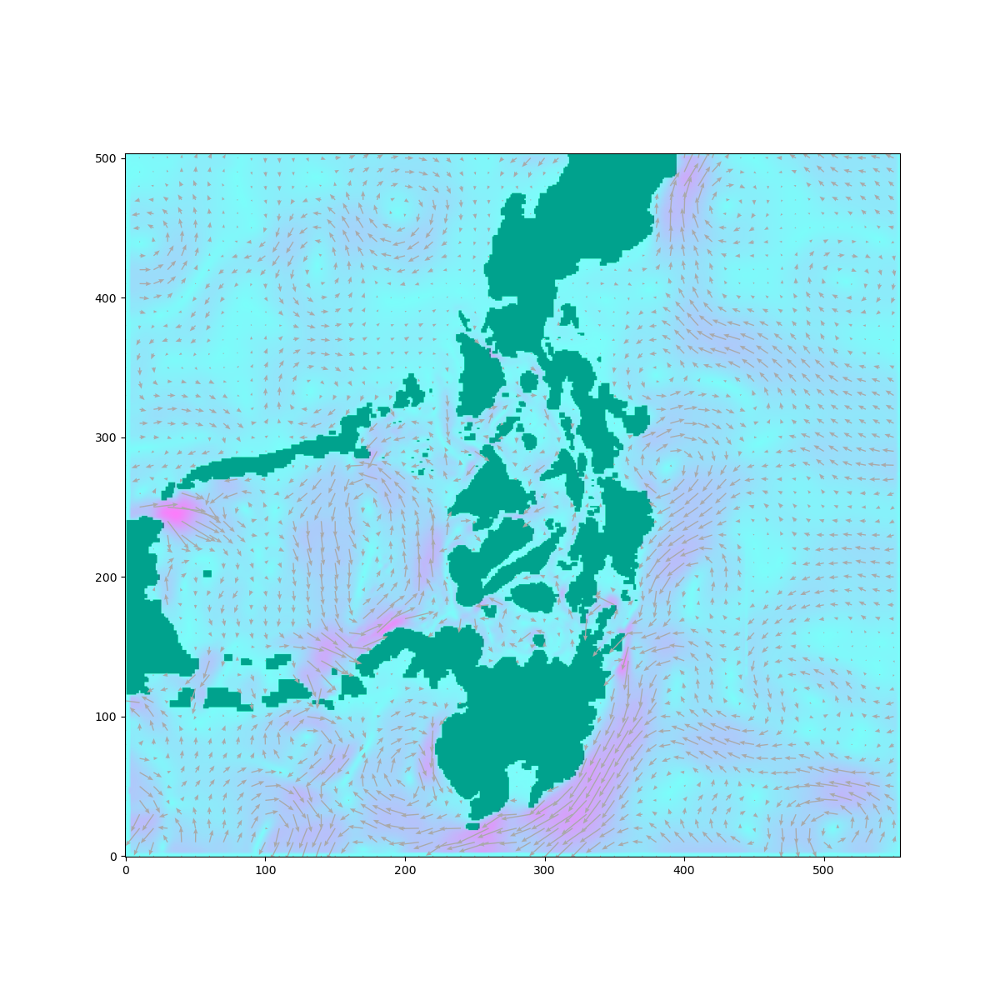

In [14]:
# plot ocean flow for a specific time (use index 0 to 99)
fig, ax = plt.subplots(figsize=(12,12))

def plot_ocean_flow(ax, time_index, us=us, vs=vs, flow_speed=flow_speed):
    qX, qY, qU, qV, qC = get_quiver_params(time_index,us=us, vs=vs)
    ax.imshow(flow_speed[time_index], cmap="cool", origin="lower")
    ax.imshow(1-mask_invert, cmap="Greens", alpha=0.5, origin="lower")
    ax.quiver(qX, qY, qU, qV, units="xy", angles="xy", color="darkgrey", width=0.8, headwidth=4)
    return ax

plot_ocean_flow(ax, 0)
plt.show()

The above picture shows the ocean flow at time point 0. The flow direction and speed are indicated by arrow directions and lengths.

**Is there long-range correlations for ocean flow**  

To identifiy long-range correlations, I randomly pick two locations from the ocean what are at least 300 km away from each other and calculate the correlation coefficient for both hori- zontal and vertical velocities. If correlation at both directions are higher than the threshold, I consider them correlated. 

In [15]:
# the average flow speed over all locations
mean_flow_speed_overall = flow_speed[flow_speed != 0].mean()
# the average flow speed at each location
mean_flow_speed_matrix = flow_speed.mean(axis=0)

# This function randomly pick a location in the ocean. I care more about the location where the flow speed
# is twice of the overall average
def pick_one_location(mask = mask_invert, flow_speed_threshold = mean_flow_speed_overall * 2):
    nx, ny = mask.shape
    while True:
        x_index = np.random.randint(nx)
        y_index = np.random.randint(ny)
        if mask[x_index, y_index] == 1 and mean_flow_speed_matrix[x_index, y_index] >= mean_flow_speed_overall:
            break
    
    return x_index, y_index

# randomly pick two long distance locations. Long distance is defined as bigger than 100.
def pick_two_longdistance_locations(mask = mask_invert, d_threshold = 100):
    while True:
        x0, y0 = pick_one_location()
        x1, y1 = pick_one_location()
        dist = np.sqrt((x1-x0)**2 + (y1-y0)**2)
        if dist > d_threshold:
            break
    return x0, y0, x1, y1

#find long range correlation.
#n_pairs of locations are randomly chosen and correlation on x-axis and y-axis velocities are calculated
#on both directions, if both correlaton efficiency are greater than the threshold, a pair of location is considered correlated.

def find_long_range_corr(corr_threshold, n_pairs=100000):
    index_list = []
    corr_list = []
    for i in range(n_pairs):
        x0, y0, x1, y1 = pick_two_longdistance_locations()
        corr_x = np.corrcoef(us[:,x0,y0], us[:,x1,y1])[0,1]
        corr_y = np.corrcoef(vs[:,x0,y0], vs[:,x1,y1])[0,1]
        if min(abs(corr_x), abs(corr_y)) > corr_threshold:
            index_list.append((x0, y0, x1, y1))
            corr_list.append(min(corr_x, corr_y))
    return index_list, corr_list

In [16]:
# find long range correlation
location_pairs,corr = find_long_range_corr(0.95, 200000)
location_pairs, corr

/Users/fuyuanjing/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2642: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/Users/fuyuanjing/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2643: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


([(273, 342, 116, 142), (264, 336, 116, 151), (115, 139, 190, 338)],
 [-0.9696573671489813, -0.9578748277881736, -0.9670906479813056])

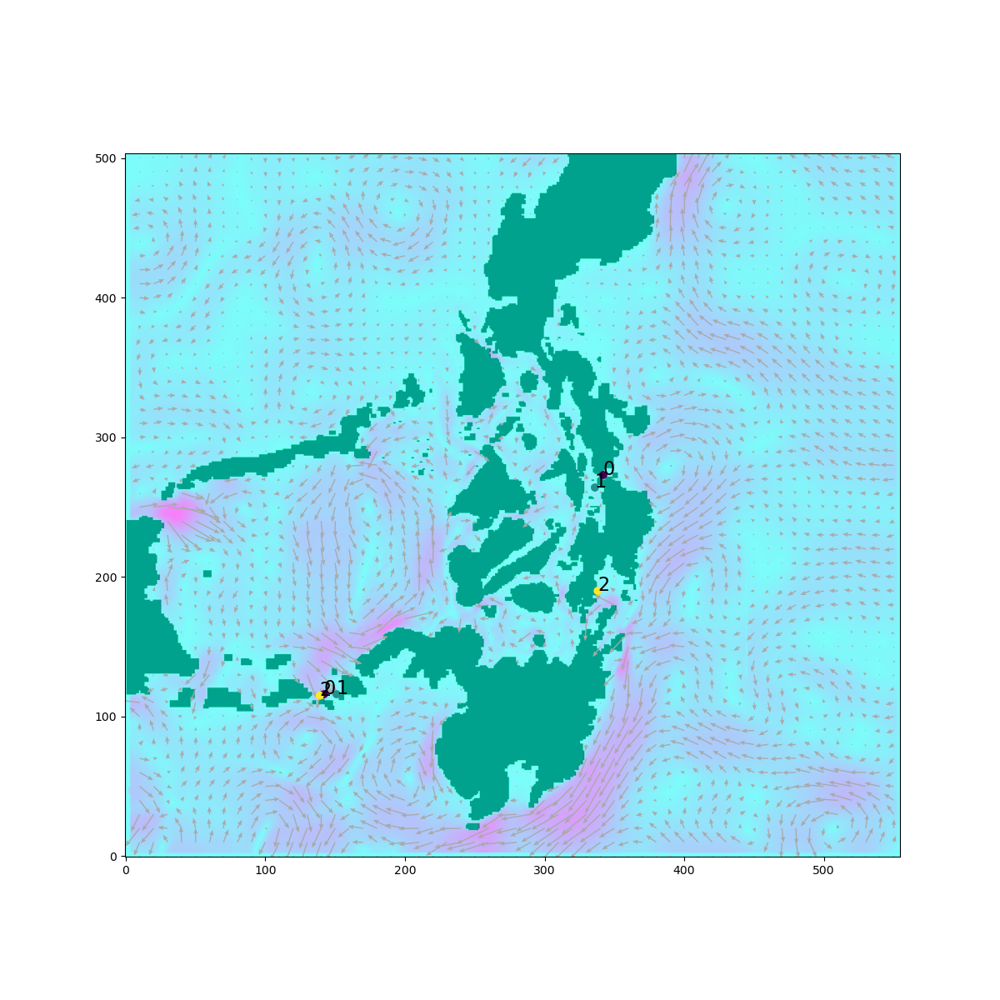

In [17]:
loc_x = []
loc_y = []
loc_color = []
loc_text = []
for i, location in enumerate(location_pairs):
    loc_x.append(location[1])
    loc_x.append(location[3])
    loc_y.append(location[0])
    loc_y.append(location[2])
    loc_color += [i,i]
    loc_text += [str(i)] * 2

fig, ax = plt.subplots(figsize=(12,12))
ax = plot_ocean_flow(ax, time_index=0)
ax.scatter(loc_x, loc_y, c = loc_color)

for i, txt in enumerate(loc_text):
    ax.annotate(txt, (loc_x[i], loc_y[i]), fontsize=16)

plt.show()

I randomly picked 200,000 pairs of locations and found a few pairs are highly correlated, that means the absolute value of correlation coefficients on both x-axis and y-axis directions are higher than 0.95. Figure above shows the pairs of locations. These pairs of locations are far away from each. But their flow velocities are highly cor- related. This is probably because these locations share similar geometry properties. They are all located at the narrow channel between those islands.

In [18]:
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation

Here is the code for makine ocean flow animation.

In [19]:
fig, ax = plt.subplots(figsize=(12,12))

def animate(i):
    ax.clear()
    plot_ocean_flow(ax, int(i/5))
    ax.set_title(f'Time = {str(3 * int(i/5))} h')
    
ani = FuncAnimation(fig, animate, frames=500, blit=False)
ani.save("ocean flow 1.mp4", writer=animation.FFMpegFileWriter(fps=24))
plt.close()

<video width=600, height=600, controls>
    <source src="ocean flow 1.mp4", type="video/mp4">
</video>

## Simulate particle movement in the ocean  

Now, I'm going to build a simulator that can track particles' movement on a time-varying flow.  

It is assumed that the velocity of a particle in the ocean, with certain coordinates, will be determined by the corresponding water flow velocity at those coordinates. I implemented a procedure to track the position and movement of multiple particles as caused by the time-varying flow given in the data set.  

Here is the idea for my ocean flow simulator:
1. Determine the time interval $\epsilon$ between the iterations and total number of iterations
2. Loop through the iterations
3. Calculate the time index which is used to get velocity
4. Loop through all the particles
5. Update the location for each particle using this function $X_{t+1} = X_t + \epsilon v(t, X_t)$. To get the velocity, use the time index and rounded $x−axis$ and $y−axis$ locations as index for the velocity matices
6. for each particle, use a list to store the trajectories. In each iteration, also update the locations in the trajectories

<img src="particle movement.svg" align="center">

In [20]:

class OceanFlowSimulator:
    def __init__(self, initial_x  = [], initial_y = [], epsilon = 0.5, us = us, vs = vs, time_gap=3, mask = mask_invert, totaltime=297):
        self.initial_x = [i for i in initial_x]
        self.initial_y = [i for i in initial_y]
        self.epsilon = epsilon
        self.iteration = np.ceil(totaltime / epsilon).astype(int)
        self.us = us
        self.vs = vs
        self.r_bound = us.shape[1]-1
        self.c_bound = us.shape[2]-1
        self.flow_speed = np.sqrt(us**2 + vs**2)
        self.time_gap = time_gap
        self.grid_gap = 3
        self.totaltime = totaltime
        self.n_particles = len(initial_x)
        self.trajectory_x = [[i] for i in initial_x]
        self.trajectory_y = [[i] for i in initial_y]
        self.ani=None
        # self.in_ocean = [True] * self.n_particles
    
    def run(self):
        current_x = self.initial_x
        current_y = self.initial_y
        for i in range(self.iteration + 1):
            ti = int(self.epsilon * i / self.time_gap)
            for j in range(self.n_particles):
                row_index = round(current_x[j])
                col_index = round(current_y[j])
                updated_x = min(current_x[j] + self.vs[ti, row_index, col_index] * self.epsilon / self.grid_gap, self.r_bound)
                updated_y = min(current_y[j] + self.us[ti, row_index, col_index] * self.epsilon / self.grid_gap, self.c_bound)
                self.trajectory_x[j].append(updated_x)
                self.trajectory_y[j].append(updated_y)
                current_x[j] = updated_x
                current_y[j] = updated_y
        
    def time_to_iteration(self, time_eclipsed):
        iteration = np.ceil(time_eclipsed / self.epsilon).astype(int)
        return iteration

    def get_iter_loc(self, time_eclipsed):
        iteration = self.time_to_iteration(time_eclipsed)
        loc_x = []
        loc_y = []
        for i in range(self.n_particles):
            loc_x.append(self.trajectory_x[i][iteration])
            loc_y.append(self.trajectory_y[i][iteration])
        return np.array(loc_x), np.array(loc_y)
    
    def get_iter_trajectory(self, time_eclipsed, trace=-1):
        iteration = self.time_to_iteration(time_eclipsed)
        tr_x = []
        tr_y = []
        if trace == -1:
            for i in range(self.n_particles):
                tr_x.append(self.trajectory_x[i][:iteration])
                tr_y.append(self.trajectory_y[i][:iteration])
        else:
            n = iteration - trace if iteration>trace else 0
            for i in range(self.n_particles):
                tr_x.append(self.trajectory_x[i][n:iteration])
                tr_y.append(self.trajectory_y[i][n:iteration])
        return np.array(tr_x), np.array(tr_y)

    def plot_helper(self, ax, time_eclipsed, trace = -1):
        i = self.time_to_iteration(time_eclipsed)
        plot_ocean_flow(ax, int(i*self.epsilon/self.time_gap), us=self.us, vs=self.vs, flow_speed=self.flow_speed)
        ax.set_title(f'Time = {i * self.epsilon} h')
        xs, ys = self.get_iter_loc(i)
        colors = ["blue"] * self.n_particles
        for p in range(self.n_particles):
            if round(xs[p]) == 503 or round(xs[p]) == 0 or round(ys[p]) == 554 or round(ys[p])==0 or mask_invert[round(xs[p]), round(ys[p])] == 0:
                colors[p] = "red"
            else:
                ax.plot(self.get_iter_trajectory(i,trace)[1][p], self.get_iter_trajectory(i,trace)[0][p], c="red", linewidth=1)
        ax.scatter(ys, xs, c=colors, s=6, zorder=1000)
        return ax

    def make_trajectory_plot(self, time_eclipsed, trace =  -1, save_to_file=None):
        if time_eclipsed > self.totaltime:
            print(f"This time {time_eclipsed} exceeds the total time of the simulation. Pick another time")
            return None
        fig, ax = plt.subplots(figsize=(10,10))
        self.plot_helper(ax, time_eclipsed, trace=trace)
        if save_to_file is not None:
            plt.savefig(save_to_file)
        plt.show()
        return None

    def make_animation(self, frames, save_to_file, interval=200,  trace=300):
        time_per_frame = self.totaltime / frames
        fig, ax = plt.subplots(figsize=(10,10))

        def animate(i):
            ax.clear()
            self.plot_helper(ax, i * time_per_frame, trace=trace)

        # I had to create a class variable to make this work
        self.ani = FuncAnimation(fig, animate, frames = frames, interval=interval, blit=False)
        self.ani.save(save_to_file, writer=animation.FFMpegFileWriter(fps=24))
        plt.close()
        return None


### Test the OceanFlowSimulator Class  

I first drew particle locations randomly on the map and simulated the particles movement for 297 hours. I was able to make plot of the particle trajectories for any specified time and create animation of the particle movement.

Note: in our dataset, time is indexed from 0 to 99. The time interval is 3 hours between two neighbor index.


In [21]:
# randomly pick n locations in the ocean
def sample_locations(n):
    nx, ny = mask_invert.shape
    loc_x = []
    loc_y = []
    loc_n = 0
    while loc_n < n:
        x_index = np.random.randint(nx)
        y_index = np.random.randint(ny)
        if mask_invert[x_index, y_index] == 1:
            loc_x.append(x_index)
            loc_y.append(y_index)
            loc_n += 1
    
    return loc_x, loc_y

Randomly pick 30 locations and run the simulation with epsilon=1. Epsilon is the time interval for each iteration of the simulation.

In [22]:
p_x, p_y = sample_locations(50)
simulator = OceanFlowSimulator(p_x, p_y, epsilon=1)
simulator.run()

The figures below show the initial, final, and an intermeidate state of simulation.

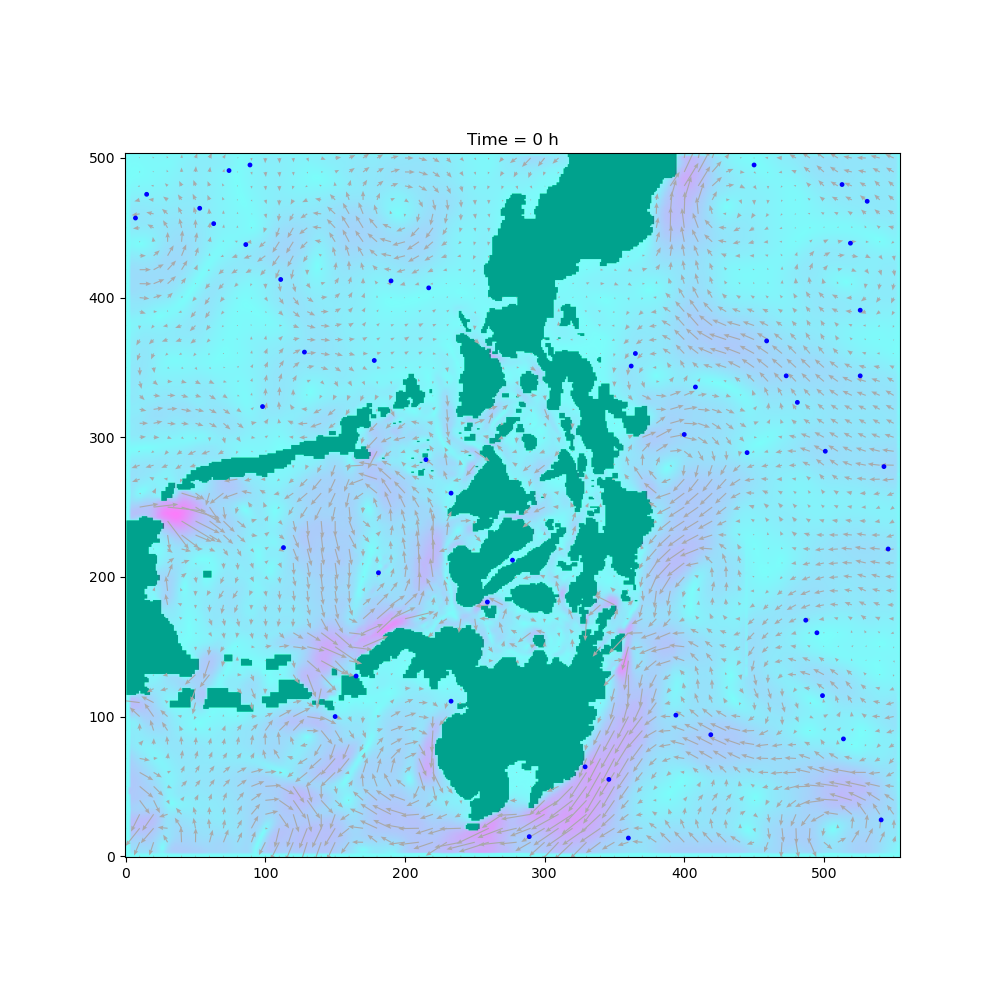

In [23]:
simulator.make_trajectory_plot(0)

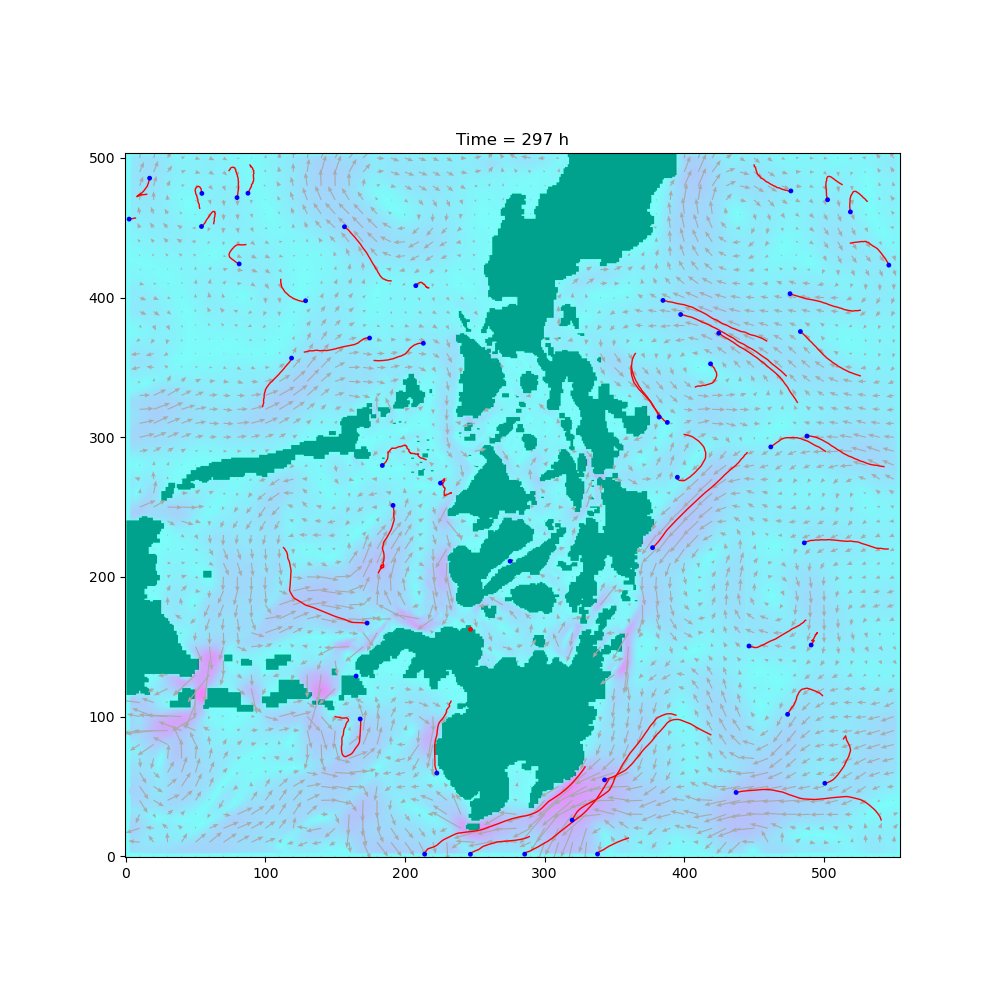

In [24]:
simulator.make_trajectory_plot(297)

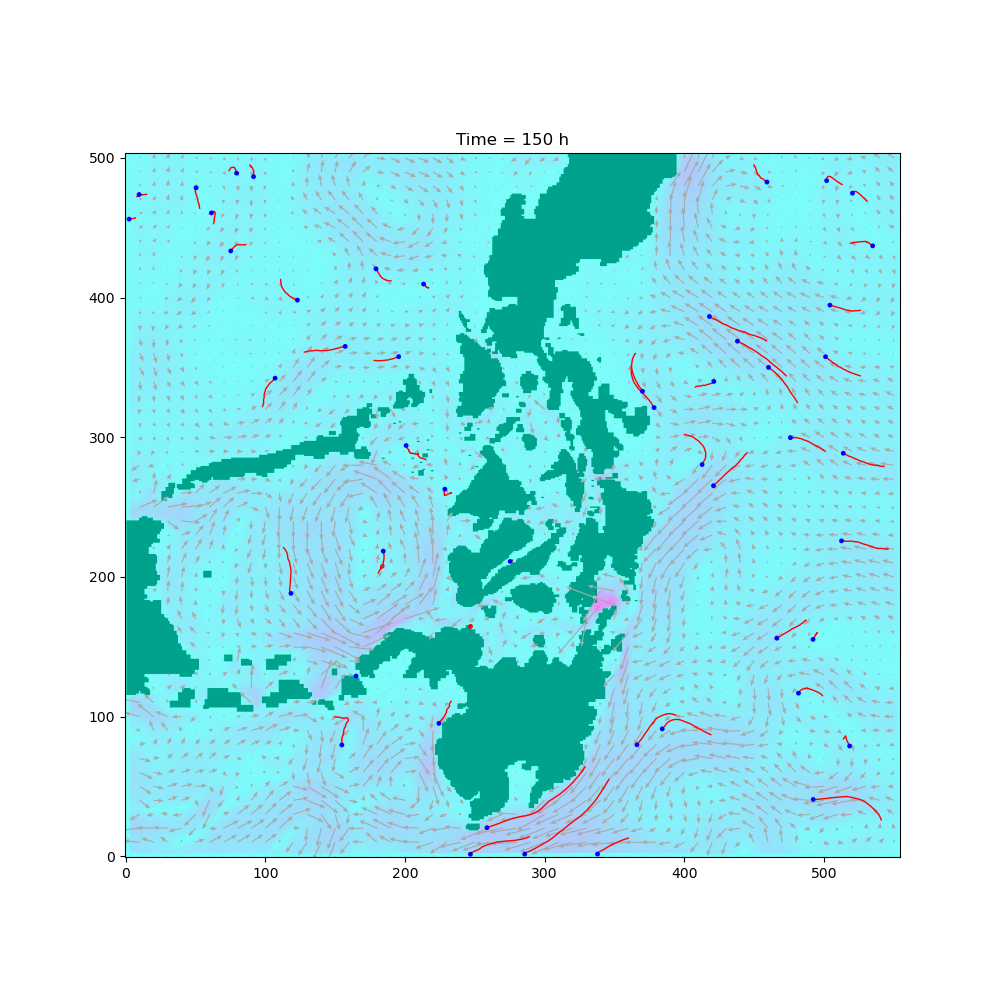

In [25]:
simulator.make_trajectory_plot(150)

I was also able to create animation of the particle movement.

Below is the code. It is commented, becuase it takes some time to run.

In [26]:
simulator.make_animation(frames=600, interval=100, save_to_file="particles movement simulation.mp4")

<video width=600, height=600, controls>
    <source src="particles movement simulation.mp4" type="video/mp4">
</video>

### Searching for crashed plane  

A plane has crashed north of Palawan at $T=0$. The exact location is unknown, but data suggests that the location of the crash follows a Gaussian distribution with mean (100, 350) (namely (300 km, 1050 km)) with variance $\sigma^2$. The debris from the plane has been carried away by the ocean flow. To help the search of plane debris, a simulation of the particle trajectories is conducted. I want to know where we would expect the particles to be at different time points.

In [27]:
# create a function to sample the locations of plane parts. 
def sample_plane_loc(n_particles, sigma):
    loc_x = np.random.normal(350, sigma, n_particles)
    loc_y = np.random.normal(100, sigma, n_particles)
    return loc_x, loc_y

I sampled locations for 100 plane parts and run the simulation.

In [28]:
plane_x, plane_y = sample_plane_loc(100, 10)
simulator = OceanFlowSimulator(plane_x, plane_y, epsilon=1)
simulator.run()

The figures below show several states of the simulation

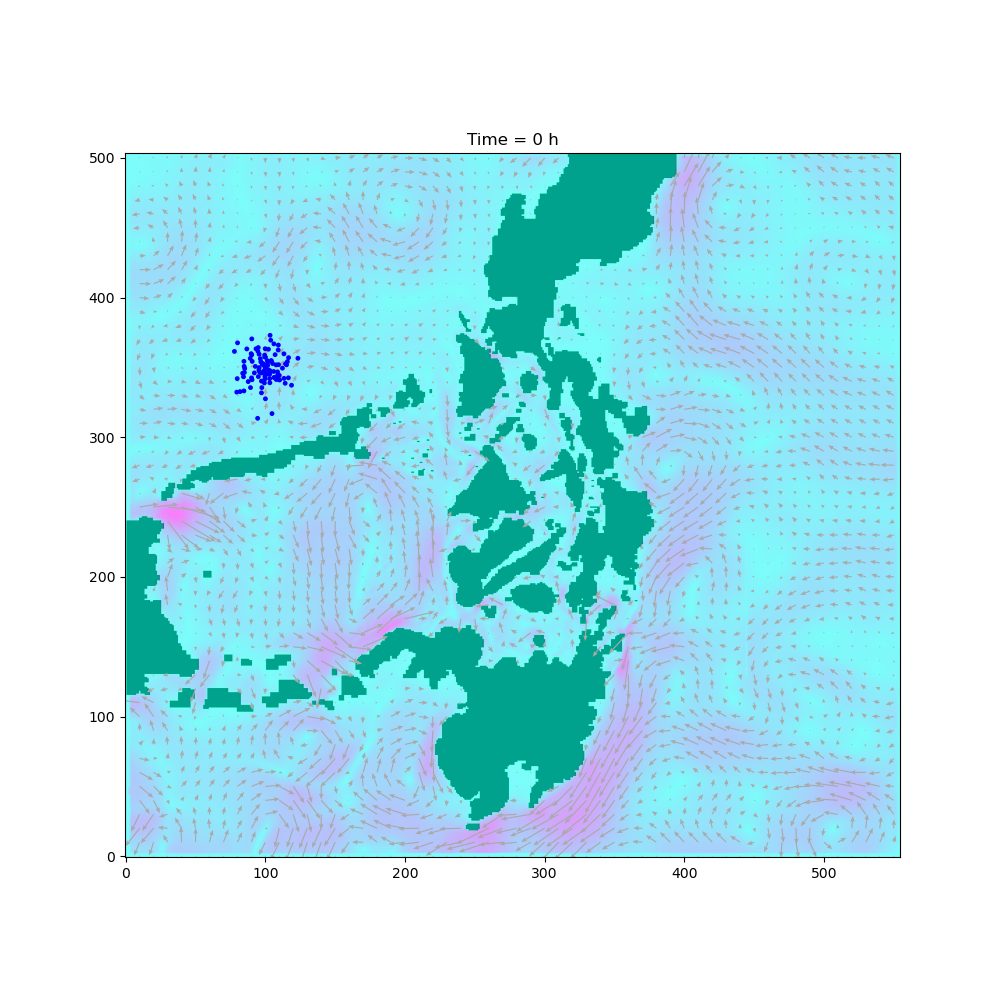

In [29]:
simulator.make_trajectory_plot(0)

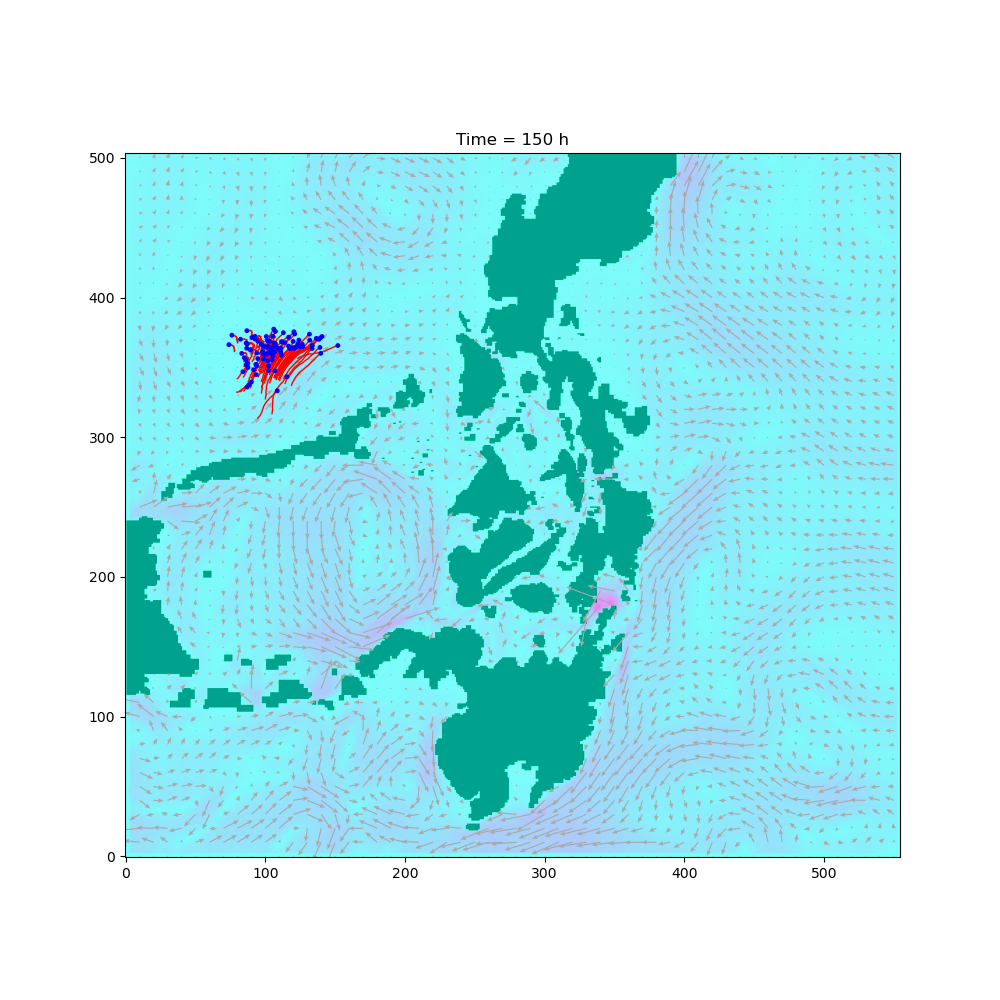

In [30]:
simulator.make_trajectory_plot(150)

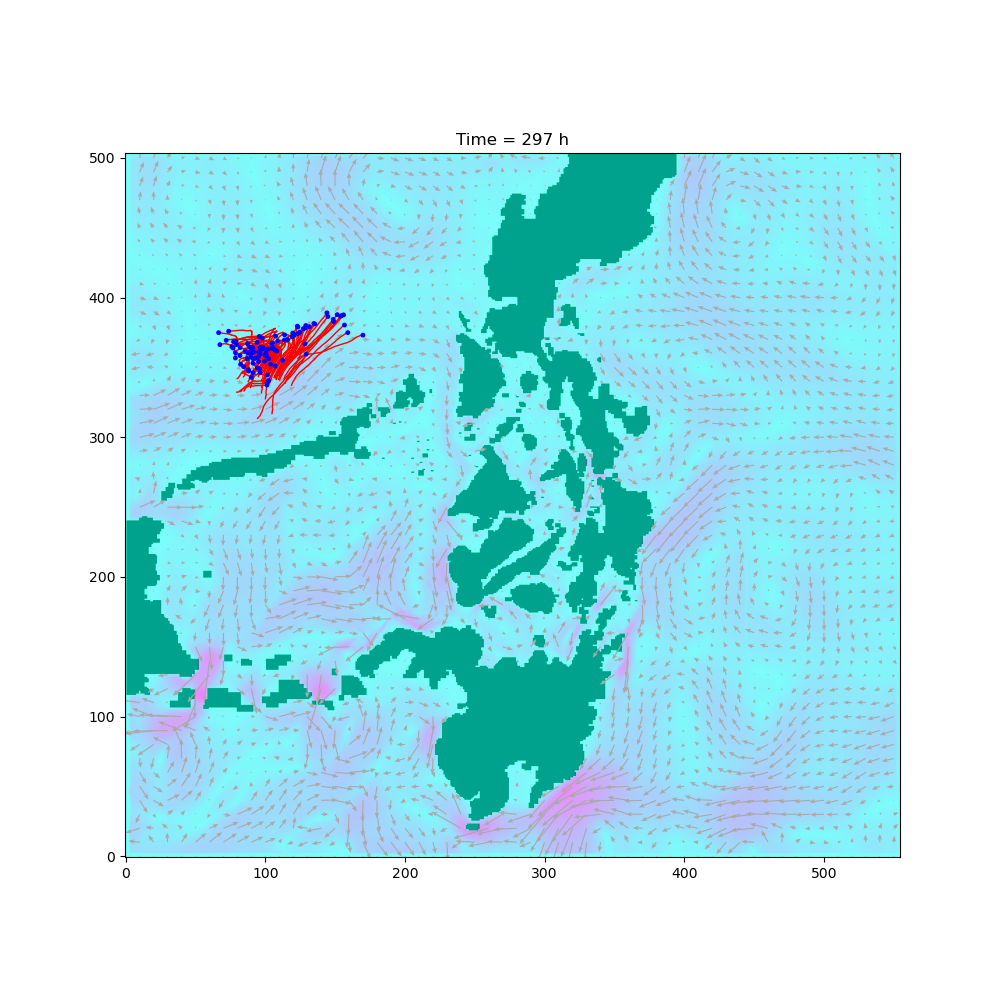

In [31]:
simulator.make_trajectory_plot(297)

**Create animation of the simulation**

In [32]:
simulator.make_animation(300, save_to_file="plane parts simulation.mp4")

<video width=600, height=600, controls>
    <source src="plane parts simulation.mp4" type="video/mp4">
</video>

In this part, the data were given for a set of physical locations, and for each location, over 100-time instances each separated by 3 hours. Given some estimated location of a crashed plance, I simulated the plane debris movement in the ocean. However, because I only have data for 100-time instances, separated by 3 hours each, I can only run such simulation for a total of 297 hours. We can see from the simulation based on this time scale, the points did not move too far. So it's difficult to predict where the debris will land.

In the following part, we change the setup of the data and use gaussian process to predict the flow for unoberved time points.

## Estimating flows with gaussian process regression  


In this part, i will perform an experiment where I can simulate larger time scales. Furthermore, I'm going to model flows as a gaussian proces to estimate some unobserved time points.

**CHANGE OF THE DATA SETUP**: Here onward, we are going to assume that the flow data available, instead of being given for measurements every 3 hours, is given for measurements every three days!. This implies that we can potentially simulate the movement of debris for almost one year.

However, to achieve a sufficiently smooth simulation, having flow data every three days is quite a stretch. Whereas in the previous part, we assumed that the flow in the ocean remains approximately the same on a period of 3 hours, to assume that this is also the case for three days does not seem correct. So, we would like to have time steps of 24 hours or possibly even smaller. Since now the time interval for each measurement is 3 days, one task is to estimate the ocean flow for those unobserved days between the measurements.

### Flow data  

I will pick the flow data at location (350, 100) as an example to illustrate the gaussian process method. At each location, I will look at the horizontal and vertical velocity seperately.

In [33]:
import scipy as sp
import copy

In [34]:
u1 = copy.deepcopy(us[:, 350, 100])
v1 = copy.deepcopy(vs[:, 350, 100])
idx = np.arange(0, 300, 3)

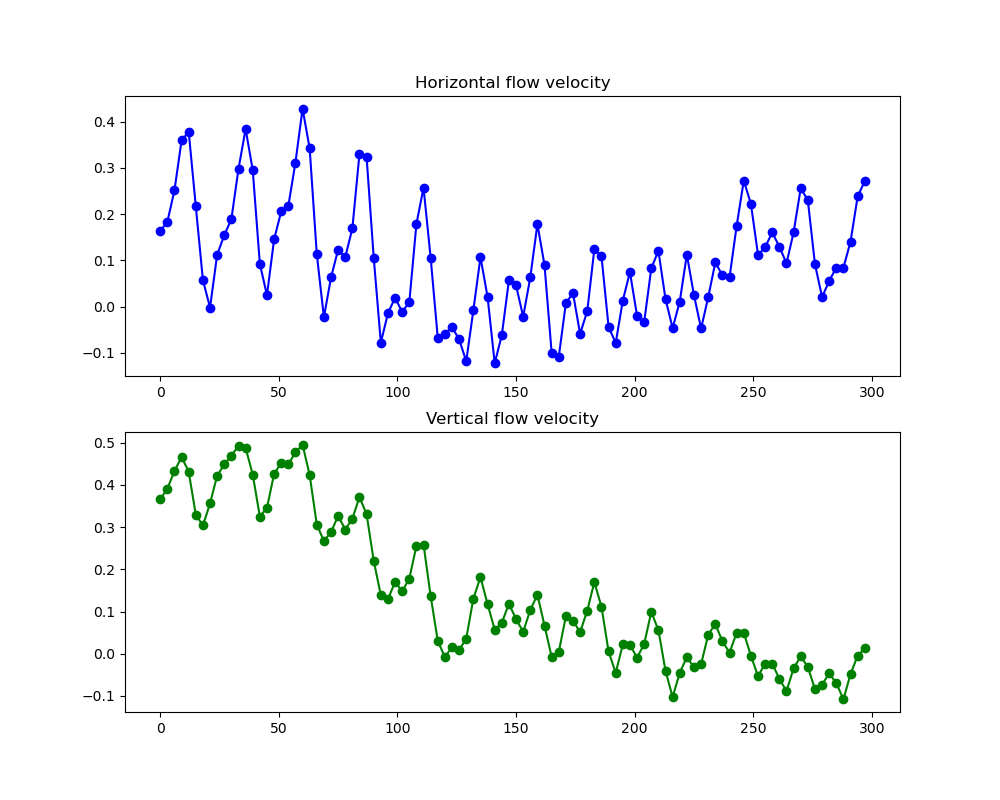

In [35]:
plt.figure(figsize=(10,8))
plt.subplot(2,1,1)
plt.plot(idx, u1, "o-", color="blue")
plt.title("Horizontal flow velocity")
plt.subplot(2,1,2)
plt.plot(idx, v1, "o-", color="green")
plt.title("Vertical flow velocity")
plt.show()

The figure above shows the horizontal and vertical flow velocity at location (350, 100) in the period of 0 to 299 days. These are the data points observed very other three days. Now the task is to predict the ocean flow for these unobserved time points between. I'm going to use gaussian process regression to do this.

### Gaussian Process Regression - from scratch  

Gaussian processes are distributions over functions $f(x)$ of which the distribution is defined by a mean function $m(x)$ and positive definite covariance function $k(x, x')$:  
$f(x) \sim \mathcal{GP}(m(x),k(x,x'))$  
where for any finite subset $X={x_1...x_n}$ of the domain of $x$, the marginal distribution is a multivariate Gaussian distribution:  
$f(X) \sim \mathcal{N}(m(X), k(X, X))$
with mean vector $\mu=m(X)$ and covariance matrix $\Sigma = k(X, X)$.  

(Reference: https://peterroelants.github.io/posts/gaussian-process-tutorial/)

For this problem, we will choose prior mean of 0 and the following squared exponential kernel function:  
$\displaystyle  K(z_ i,z_ j) = a ^2\exp \left(-\frac{\| z_ i-z_ j\| ^2}{2\ell ^2}\right).$  
where the parameters will be $\theta = \{ \sigma ,\ell \}$  

We aslo consider the noise $\tau$ of observed data. First of all, I fix $\tau =  0.001$ and use cross validation to find otpimal parameters for the kernel function. Here are the step:  

- set prior mean to zero
- construct covariance matrix using the RBF kernel and selected set of parameters
- Compute the conditional mean and variance of the testing data points, given the mean and variance of the training data points and the data itself. Recall that:  
  $\displaystyle \mu _{\mathbf{X}_2|\mathbf{X}_1} = \mu _2 + \Sigma _{21}(\Sigma _{11}+\tau I)^{-1}(\mathbf{x}_1-\mu _1).$  
  $\displaystyle \Sigma _{\mathbf{X}_2|\mathbf{X}_1} = \Sigma _{22} - \Sigma _{21}(\Sigma _{11}+\tau I)^{-1}\Sigma _{12}.$  
In this case, $X_2$ are the velocities for the testing data-points, $X_1$ are the velocities for the training data-points. $\mu_2$ are the mean velocities for the testing data-points. $\mu_1$ are the mean velocities for the training data-points. $\Sigma_{11}$ is the covariance of the training data-points. $\Sigma_{22}$ is the covariance of the testing data-points. $\Sigma_{12}$ is the cross-covariance. $x_1$ are the observed velocities for the training data-points. Finally, $\tau$ is the parameter indicating the variance of the noise in the observations. I set $\tau = 0.001$ here.
- compute the log marginal likelihood on the testing data.
- for each possible set of parameters, I can calculate the average log marginal likelihood for the $k$ partitions of the data. Find parameters that maximize log marginal likelihood.

**NOTE**  
$\Sigma_{11}+\tau I$ is symmetric, $\Sigma_{11}+\tau I =  (\Sigma_{11}+\tau I)^T$. Also note that $\Sigma_{21} = \Sigma_{12}^T$  
So we can write $\Sigma _{21}(\Sigma _{11}+\tau I)^{-1} = ((\Sigma _{11}+\tau I)^{-1} \Sigma_{12})^T$.
We can calculate the $(\Sigma _{11}+\tau I)^{-1} \Sigma_{12}$ term with Scipy's solve function. This is more efficient than calculating the inverse matrix.



In [36]:
from sklearn.model_selection import train_test_split, KFold
import itertools

def squared_exponential(zi, zj, a, ell):
    d = np.subtract.outer(zi, zj)
    return a**2 * np.exp(-d**2 / (2*ell**2))


def GP_predict(x1, y1, x2, tau, kernel_func, **kwargs):
    """
    Calculate the posterior mean and covarance matrix for y2 based on the corresponding input x2,
    observation (x1, y1), and the prior kernel function
    """
    # compute covariance matrices
    sigma_11 = kernel_func(x1, x1, **kwargs) + tau * np.eye(len(x1))
    sigma_12 = kernel_func(x1, x2, **kwargs)
    # sigma_21 = kernel_func(x2, x1, **kwargs)
    sigma_22 = kernel_func(x2, x2, **kwargs)
    # using solve function is more efficient than computing the inverse matrix
    solved = sp.linalg.solve(sigma_11, sigma_12).T
    # compute posterior mean and covariance
    mu_2 = np.dot(solved, y1)
    sigma_2 = sigma_22 - np.dot(solved, sigma_12)
    # mu_2 = sigma_21.dot(np.linalg.slove(sigma_11, y1))
    # sigma_2 = sigma_22 - sigma_21.dot(np.linalg.solve(sigma_11, sigma_12))
    return mu_2, sigma_2

def lml(y_test, mu, sigma):
    return sp.stats.multivariate_normal.logpdf(y_test, mu, sigma)

def search_params(x, y, avals, ells, taus):
    """
    Use cross validation to search optimal parameters for the kernel function.
    This function returns a pandas DataFrame containing different combination of parameters and log marginal likehood
    Params:
        x, y: training data x and y
        avals: a list of values for a
        ells: a list of values for ell
        taus: a list of values for tau
    Return:
        a pandas DataFrame with optimal parameters and a DataFrame containing all results
    """
    n_fold = 10
    df = pd.DataFrame([p for p in itertools.product(avals, ells, taus)], columns=["a", "ell", "tau"])
    lmls = []
    kf = KFold(n_splits=n_fold, shuffle=True, random_state=1)
    splits = [s for s in kf.split(x)]
    for i in range(df.shape[0]):
        a, ell, tau = df.iloc[i]
        # print(a, ell, tau)
        log_ml = 0
        for train_index, test_index in splits:
            X_train, X_test = x[train_index], x[test_index]
            y_train, y_test = y[train_index], y[test_index]
            # print(X_train, y_train)
            mu, sigma = GP_predict(X_train, y_train, X_test, tau, squared_exponential, a=a, ell=ell)
            # print(mu, sigma)
            log_ml += lml(y_test, mu, sigma)
        lmls.append(log_ml/n_fold)
    df["lml"] = lmls
    max_lml = df["lml"].max()
    return df[df["lml"]==max_lml], df
    

### Parameters searching  

I first fix the value of $\tau$ at 0.001, and search the value of $a$ from 0.1 to 2 and the value of $\ell$ from 0.5 to 12. I perform the parameters searching for the data on both horizontal and vertical directions.

Optimal parameters for the horizontal direction data.

In [37]:

avals = np.arange(0.1, 2, 0.05)
ells = np.arange(0.5, 12, 0.5)
taus = [0.001]
optimal_params, _ = search_params(idx, u1, avals, ells, taus)
optimal_params

,a,ell,tau,lml
750,1.7,7.5,0.001,22.301714


Optimal parameters for the vertial direction data.

In [38]:
optimal_params, params_df = search_params(idx, v1, avals, ells, taus)
optimal_params

,a,ell,tau,lml
820,1.85,8.0,0.001,23.079325


To better understand the effect of different kernel parameters on the performance of the model, I plot the log marginal likelihood over the search space.

In [39]:
from mpl_toolkits.mplot3d import Axes3D

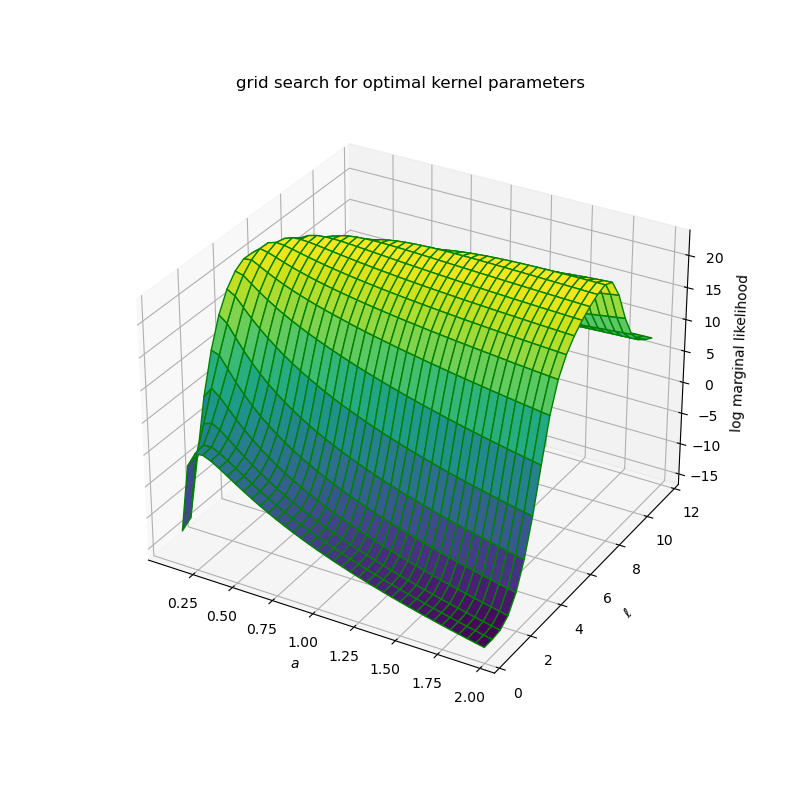

In [40]:
x, y = np.meshgrid(avals, ells)

z = params_df["lml"].values.reshape(x.T.shape)

fig = plt.figure(figsize=(8,8))
 
# syntax for 3-D plotting
ax = plt.axes(projection ='3d')

# syntax for plotting
ax.plot_surface(x.T, y.T, z, cmap ='viridis', edgecolor ='green')
ax.set_title('grid search for optimal kernel parameters')
ax.set_xlabel("$a$")
ax.set_ylabel("$\ell$")
ax.set_zlabel("log marginal likelihood")
plt.show()

The figure above shows that the parameter $\ell$ of the kernel function has a bigger impact on the performance of the model. The optimal value for $\ell$ is around 8. 

RBF kernel defines covariance function that decays smoothly with distance. The idea is that similar inputs have similar outputs. The Euclidean distance term in the RBF function quantifies the similarity. The kernel parameters $a$ and $\ell$ control amplitudes and wiggliness of the functions. The intuition of RBF kernel is taht function values at nearby inputs are more correlated than function values at far away inputs.

### Gaussian process regression  

Now, I can make predictions based on train_x, train_y, test_x, and the optimal kernel parameters. I will still use the flow data of horizontal direction at location (350, 100) to test the model. The 100 data points are splitted into 90 training points and 10 test points with the `train_test_split` function.

In [41]:
a = 1.7
ell = 7.5
tau = 0.001
X_train, X_test, y_train, y_test = train_test_split(idx, u1, test_size=0.1, random_state=10)
y_pred, cov_pred = GP_predict(X_train, y_train, X_test, tau, squared_exponential, a=a, ell=ell)
print("Log marginal likelihood on test data is ", lml(y_test, y_pred, cov_pred))
pd.DataFrame({"y_test":y_test, "y_pred": y_pred})

Log marginal likelihood on test data is  22.873472005202004


,y_test,y_pred
0,0.311820,0.318831
1,0.092200,0.096837
2,-0.118480,-0.104633
3,0.257410,0.229816
4,0.074764,0.043906
5,0.359700,0.365648
6,0.067625,0.075856
7,-0.044476,-0.021684
8,0.105550,0.089079
9,-0.034040,-0.018200


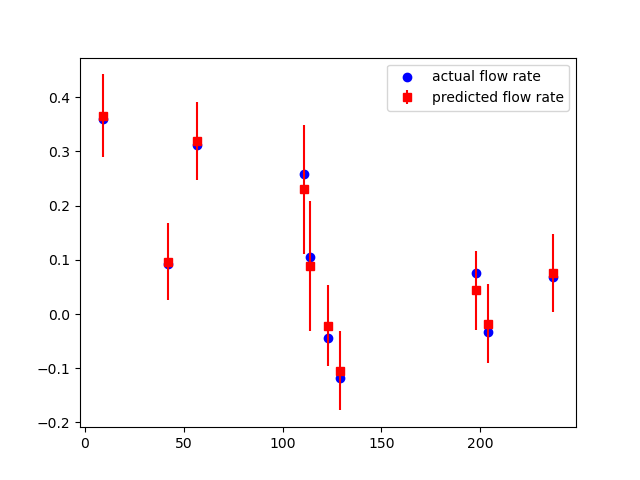

In [42]:
errors = np.sqrt(np.diag(cov_pred))
plt.subplots()
plt.scatter(X_test, y_test, color="blue", label="actual flow rate")
plt.errorbar(X_test, y_pred, yerr = 2 * errors, fmt = "s", color="red", label="predicted flow rate")
plt.legend()
plt.show()

The above figure shows the predicted flow rate is very close to the actual flow rate. One advantage of gaussian process regression is that it does not only predict a number, but also gives a distribution of the prediction.

### More study on the hyper-parameters  

I earlier fix the noise $\tau$ at 0.001. In the following I'm going to do a grid search of hyper-parameters on $a$, $\ell$, and $\tau$ to study the effects of these parameters on the performance of the model.  

I will also perform grid search of hyper-parameters for data at other locations to check how parameters vary among different locations.

In [43]:
avals = np.arange(0.5, 2, 0.1)
ells = np.arange(2,10,0.5)
taus = np.arange(0.001, 0.005, 0.0005)
optimal_params, params_df = search_params(idx, u1, avals, ells, taus)
optimal_params

,a,ell,tau,lml
1624,1.7,7.5,0.001,22.301714


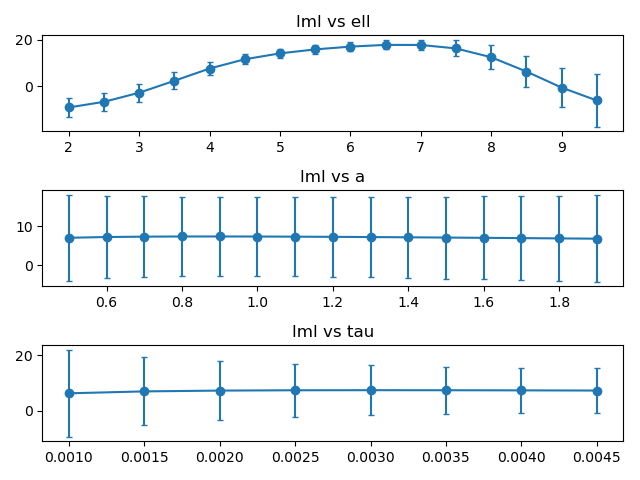

In [44]:
# check how the hyper-parameters of the kernel function affect the log marginal likelihood
st1 = params_df.groupby("ell")["lml"].agg([np.mean, np.std])
st2 = params_df.groupby("a")["lml"].agg([np.mean, np.std])
st3 = params_df.groupby("tau")["lml"].agg([np.mean, np.std])

fig, (ax1, ax2, ax3) = plt.subplots(3,1)
ax1.errorbar(st1.index, st1["mean"], yerr=st1["std"], marker="o", capsize=2)
ax1.set_title("lml vs ell")

ax2.errorbar(st2.index, st2["mean"], yerr=st2["std"], marker="o", capsize=2)
ax2.set_title("lml vs a")

ax3.errorbar(st3.index, st3["mean"], yerr=st3["std"], marker="o", capsize=2)
ax3.set_title("lml vs tau")
plt.tight_layout()
plt.show()

The above figure shows that parameter $\ell$ has the biggest impact on the performance of the model. The optimal range for $\ell$ is between 5 and 7.5.

I also did hyper-parameters search for other 10 randomly picked locations. 

In [45]:
# avals = np.arange(0.5, 2, 0.1)
# ells = np.arange(2,10,0.5)
# taus = np.arange(0.001, 0.005, 0.0005)
# xs, ys = pick_n_location(n=10)
# locations = list(zip(xs, ys))
# results_10 = pd.DataFrame(columns=["row", "col", "direction", "a", "ell", "tau", "lml"])
# for loc in locations:
#     r, c = loc
#     params, _ = search_params(idx, us[:,r,c], avals, ells, taus)
#     d = dict(row=r, col=c, direction="x", 
#             a=params.iloc[0]["a"], ell=params.iloc[0]["ell"], tau=params.iloc[0]["tau"], lml=params.iloc[0]["lml"])
#     results_10 = results_10.append(d, ignore_index=True)
#     params, _ = search_params(idx, vs[:,r,c], avals, ells, taus)
#     d = dict(row=r, col=c, direction="y", 
#             a=params.iloc[0]["a"], ell=params.iloc[0]["ell"], tau=params.iloc[0]["tau"], lml=params.iloc[0]["lml"])
#     results_10 = results_10.append(d, ignore_index=True)

In [46]:
# results_10.to_csv("parameters for 10 locations.csv")

In [45]:
results_10 = pd.read_csv("parameters for 10 locations.csv", index_col=0)
results_10

,row,col,direction,a,ell,tau,lml
0,52,189,x,0.7,6.5,0.0010,18.987150
1,52,189,y,0.6,6.5,0.0015,17.568856
2,136,122,x,1.7,6.5,0.0010,18.017733
3,136,122,y,1.9,5.5,0.0025,10.084637
4,152,359,x,1.5,7.5,0.0015,17.459544
5,152,359,y,1.9,7.0,0.0010,19.951736
6,292,526,x,0.6,7.0,0.0010,22.760206
7,292,526,y,0.5,9.5,0.0010,26.112857
8,52,332,x,0.6,6.5,0.0015,17.144360
9,52,332,y,1.9,8.0,0.0010,20.526066


In [46]:
results_10[["a", "ell", "tau", "lml"]].apply([np.mean, np.std], axis=0)

,a,ell,tau,lml
mean,0.985000,7.175000,0.001250,19.895493
std,0.581536,0.977039,0.000473,3.781842


The average of the optimal hyper-parameters at those locations are shown in the above table. 

### Compare with sklearn gaussian process regressor  

The parameters of the kernel function can be computed by finding values of the parameters to maximize the log marginal likelihood. This is to take derivative of log marginal likelihood with respect to the parameters and solve the function. Usually gradient ascent approach is used to solve this problem.  

In this part, I'm going to compare the sklearn gaussian process regressor with the one I built.

In [47]:
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, WhiteKernel

In [48]:
kernel = 1.0 * RBF(length_scale=5, length_scale_bounds=(2, 12)) + WhiteKernel(0.001, noise_level_bounds=(1e-5, 0.01))
gpr = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10)
gpr.fit(X_train.reshape(-1,1), y_train)
y_mean, y_cov = gpr.predict(X_test.reshape(-1,1), return_cov=True)

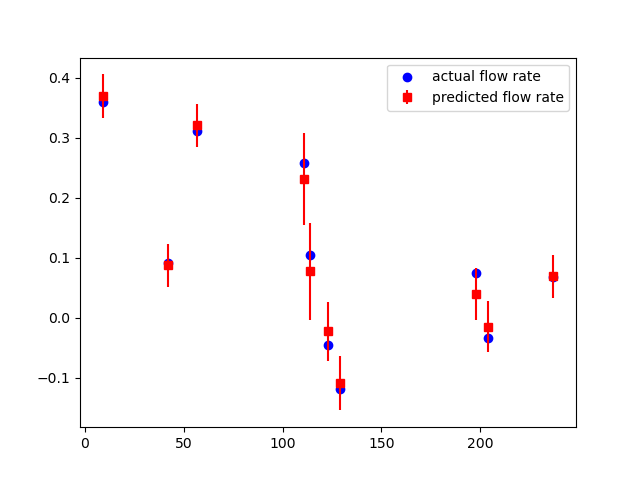

In [49]:
errors = np.sqrt(np.diag(y_cov))
plt.subplots()
plt.scatter(X_test, y_test, color="blue", label="actual flow rate")
plt.errorbar(X_test, y_mean, yerr = 2 * errors, fmt = "s", color="red", label="predicted flow rate")
plt.legend()
plt.show()

In [50]:
gpr.kernel_

0.174**2 * RBF(length_scale=4.78) + WhiteKernel(noise_level=7.67e-05)

In [51]:
print("The log marginal likelihood on test data is ", lml(y_test, y_mean, y_cov))

The log marginal likelihood on test data is  26.20973662689645


Compared with my from-scrach gaussian process regression, the sklearn GPR predicted very similar mean values, but the variances look smaller. The log marginal likelihood on test data for sklearn GPR is bigger, that is 26.2 vs 22.9. The optimal parameters of the kernel function are shown above. They are slightly different from my grid search results. This maybe because in the cross validation method, it is the average log marginal likelihood on all validation data that is maximized, while for the sklearn GPR the log marginal likelihood on the training data is maximized.

### Predict unobserved ocean flow  

Recall that we have assumed our 100 observations came at a rate of one every three days. We are going to assume that when we advance to our simulations, we will choose a smaller time step. Thus, we need to interpolate how the flow would look like at some unobserved points.  

I want to know the flows every day, so there will be two unknown points between two observations. I will use gaussian process regression to predict those unobserved ocean flows.

In [52]:
# we calculated the average optimal parameters for 10 randomly selected locations
# we can use these paramters to predict the ocean flows for all locations.
def predict_flow1(observed_y):
    """
    return the flow rate for 300 days, among which 100 are actual observations and 200 are predictions.
    """
    observed_x = np.arange(0, 300, 3)
    idx = np.arange(300)
    a, ell, tau = 0.985, 7.175, 0.00125
    y_pred, y_cov = GP_predict(observed_x, observed_y, idx, tau, squared_exponential, a=a, ell=ell)
    y_pred[observed_x] = observed_y
    return y_pred, y_cov

# we can also predict the ocean flow using sklearn GPR
# Then the parameters will be optimized for each location. This can be huge computation work
def predict_flow2(observed_y):
    """
    return the flow rate for 300 days, among which 100 are actual observations and 200 are predictions.
    """
    observed_x = np.arange(0, 300, 3)
    idx = np.arange(300)
    kernel = 1.0 * RBF(length_scale=5, length_scale_bounds=(4, 10)) + WhiteKernel(0.001, noise_level_bounds=(1e-5, 0.01))
    gpr = GaussianProcessRegressor(kernel=kernel)
    gpr.fit(observed_x.reshape(-1,1), observed_y)
    y_pred, y_cov = gpr.predict(idx.reshape((-1,1)), return_cov=True)
    y_pred[observed_x] = observed_y
    return y_pred, y_cov


Let's compare the predicted flow rate.

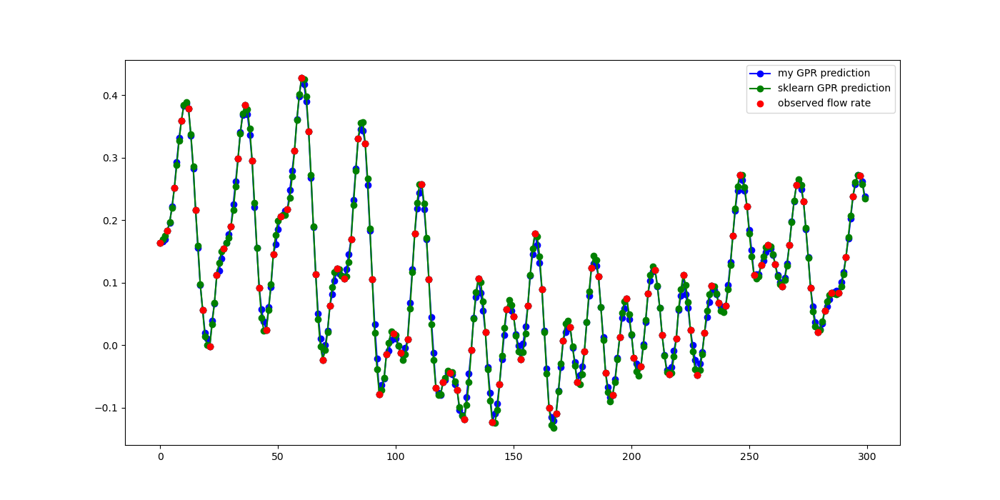

In [53]:
y_pred1, y_cov1 = predict_flow1(u1)
y_pred2, y_cov2 = predict_flow2(u1)
plt.figure(figsize=(14,7))
plt.plot(np.arange(300), y_pred1, '-o', color="blue", label="my GPR prediction")
plt.plot(np.arange(300), y_pred2, '-o', color="green", label="sklearn GPR prediction")
plt.plot(np.arange(0, 300, 3), u1, 'o', color="red", label="observed flow rate")
plt.legend()
plt.show()

The predicted flow rates of two methods are very close to each other.

What about running time?

In [56]:
import time

In [57]:

start_time = time.time()
for i in range(1000):
    predict_flow1(u1)
print("Run my GPR function: ", (time.time() - start_time)/1000)

start_time = time.time()
for i in range(1000):
    predict_flow2(u1)
print("Run sklearn GPR function: ", (time.time() - start_time)/1000)

Run my GPR function:  0.002293718099594116
Run sklearn GPR function:  0.03296761298179626


My GPR function is 10 time faster, because the parameters are already selected. There is no parameters search any more. I'm going to use this function to predict the ocean flows for all 504x555 locations.

In [58]:
import tqdm

In [331]:
# # predict the missing points for all ocean locations
# start_time=time.time()
# _, row, col = us.shape
# us_new = np.zeros((300, row, col))
# vs_new = np.zeros((300, row, col))
# for b in tqdm.tqdm(range(row)):
#     for c in range(col):
#         if mask_invert[b, c]:
#             us_new[:,b,c], _ = predict_flow1(us[:,b,c])
#             vs_new[:,b,c], _ = predict_flow1(vs[:,b,c])
# np.save("us_new.npy", us_new)
# np.save("vs_new.npy", vs_new)
# print("it took {} seconds to compute the new matrices".format(time.time()-start_time))

100%|██████████| 504/504 [17:58<00:00,  2.14s/it]


it took 1080.5458707809448 seconds to compute the new matrices


In [54]:
us_new = np.load("us_new.npy")
vs_new = np.load("vs_new.npy")

## Large scale simulation of the crashed plane parts movement   


With the new ocean flow data predicted, I can run a simulation for longer time. This allows some debris to arrive on land. The simulation will tell us where are some possible places along the coast where one can find debris.  

We have assumed that the place crashed around location (350, 100). The distribution of plane particles is considered as bivariate gaussion. I have sampled 100 particles at location (350, 100) with a sigma of 10 in the earlier simulation. I'm going to use these sampled particles again here to run a simulation for longer time. I run the simulation for 6000 hours, i.e. 250 days.

In [55]:
plane_simulator = OceanFlowSimulator(plane_x, plane_y, epsilon=1, us=us_new, vs=vs_new, time_gap=24, totaltime=6000)
plane_simulator.run()

The figures below show a few states of the simulation.

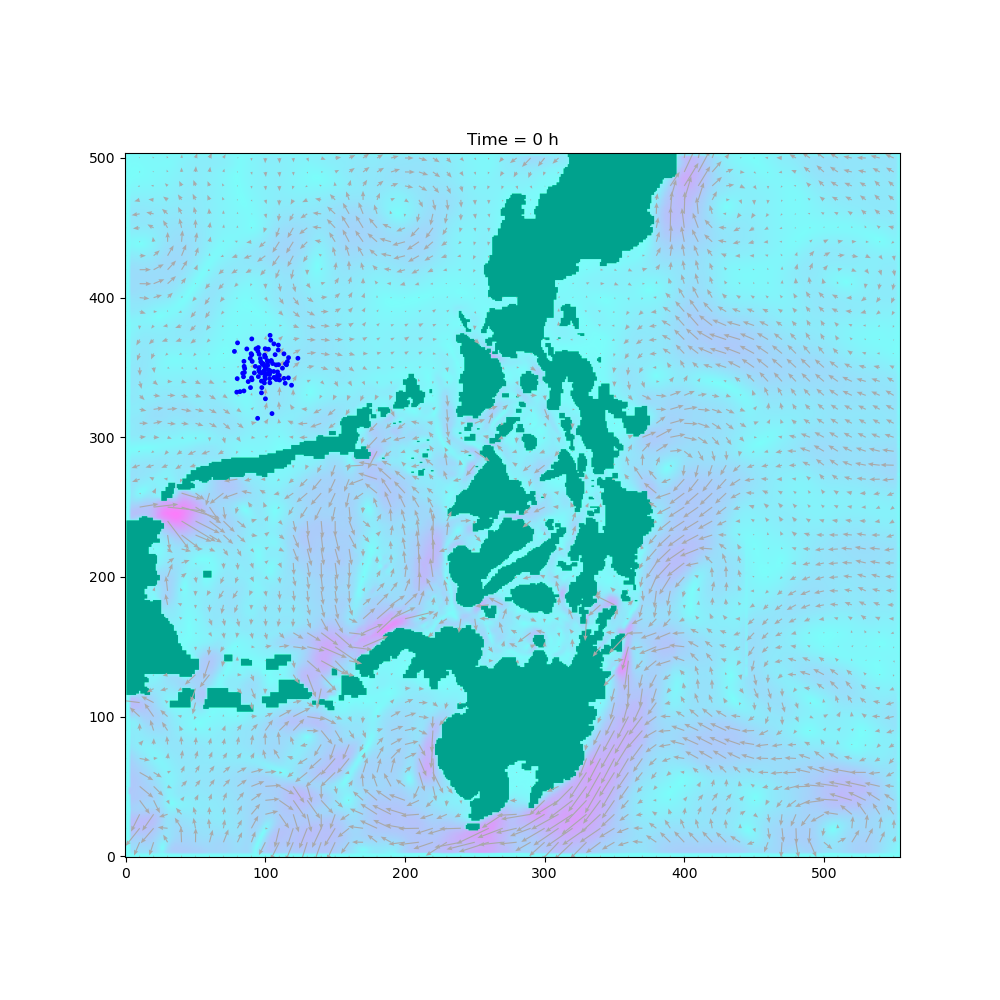

In [56]:
plane_simulator.make_trajectory_plot(0, trace=300)

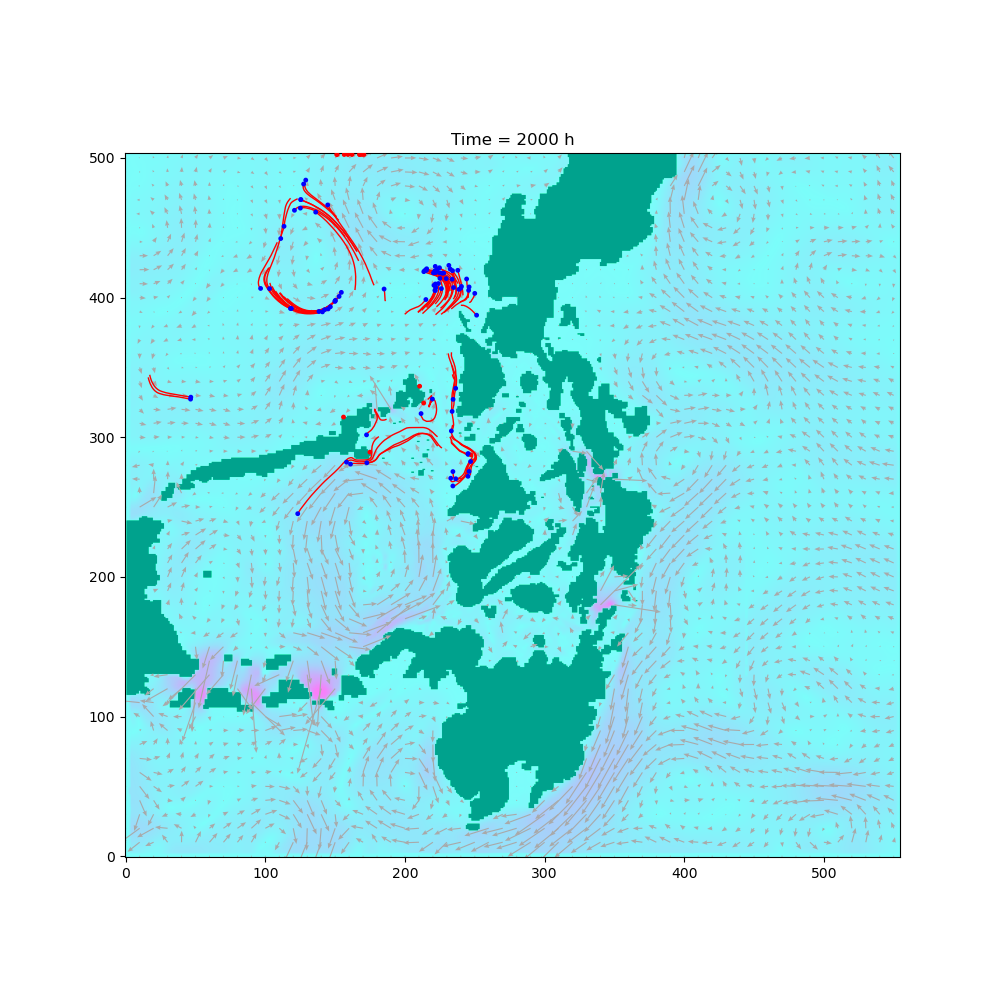

In [57]:
plane_simulator.make_trajectory_plot(2000, trace=300)

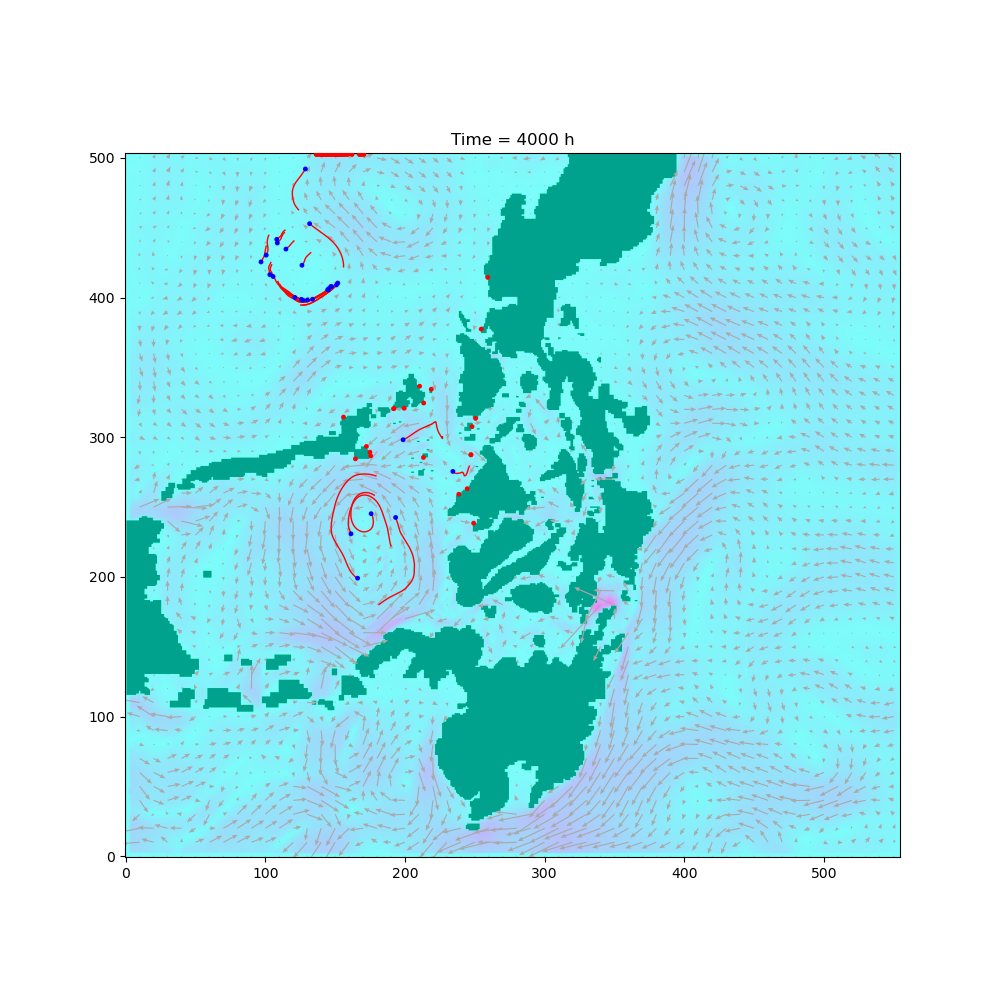

In [58]:
plane_simulator.make_trajectory_plot(4000, trace=300)

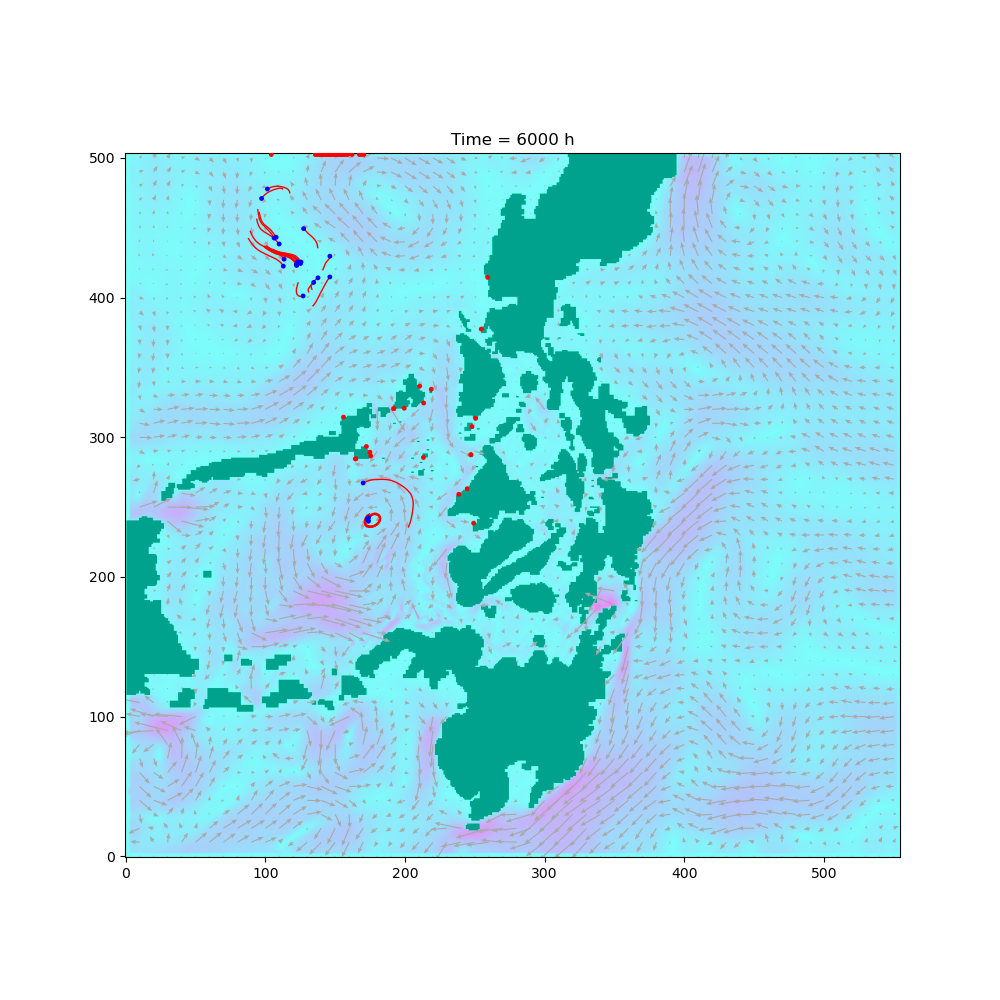

In [59]:
plane_simulator.make_trajectory_plot(6000, trace=300)

**Create animation for the simulation**

In [61]:
# plane_simulator.make_animation(6000, save_to_file="plane parts simulation 6000h.mp4", trace=300)

<video width="600" height="600" controls>
  <source src="plane parts simulation 6000h.mp4" type="video/mp4">
</video>

After 6000 hours, some particles arrive on land, while some particles are still in the ocean. The red dots in the above figure indicate the landed plane debris. If one is going to search the plane debris, these are the coast areas that one can look for.

## Set monitoring stations on the coast  


Now suppose we want to set some new monitoring stations on the coast to monitor general debris, where should the new stations be located. Using the tools I built above, I simulated the trajectories of 1000 particles, initialized at random locatons uniformly distributed on the map. The simulation was run for 6000 hours.

In [62]:
def sample_locations(n):
    nx, ny = mask_invert.shape
    loc_x = []
    loc_y = []
    loc_n = 0
    while loc_n < n:
        x_index = np.random.randint(nx)
        y_index = np.random.randint(ny)
        if mask_invert[x_index, y_index] == 1:
            loc_x.append(x_index)
            loc_y.append(y_index)
            loc_n += 1
    
    return loc_x, loc_y

In [63]:
loc_x, loc_y = sample_locations(1000)
debris_simulator = OceanFlowSimulator(loc_x, loc_y, epsilon=1, us=us_new, vs=vs_new, time_gap=24, totaltime=6000)
debris_simulator.run()

The figure below shows the intitial location of 1000 randomly picked particles.

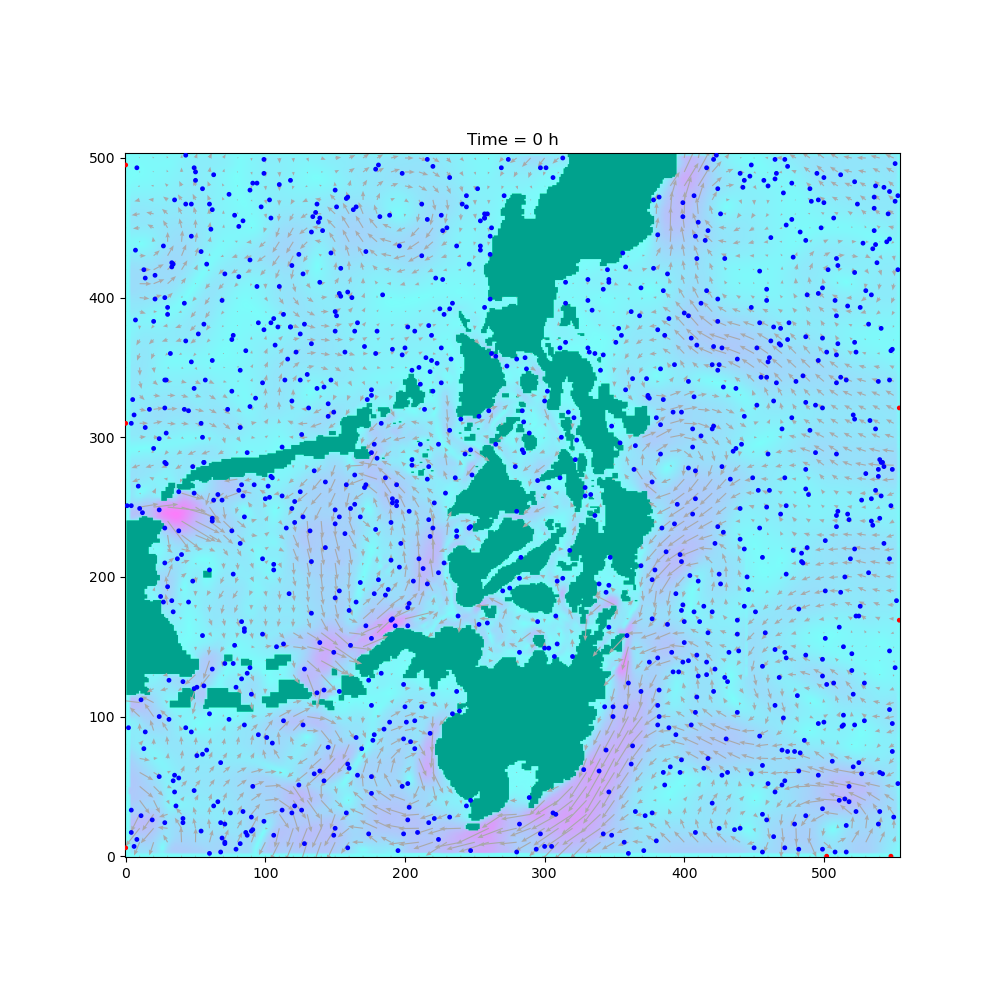

In [64]:
debris_simulator.make_trajectory_plot(0)

The figure below shows the final state of the simulation.

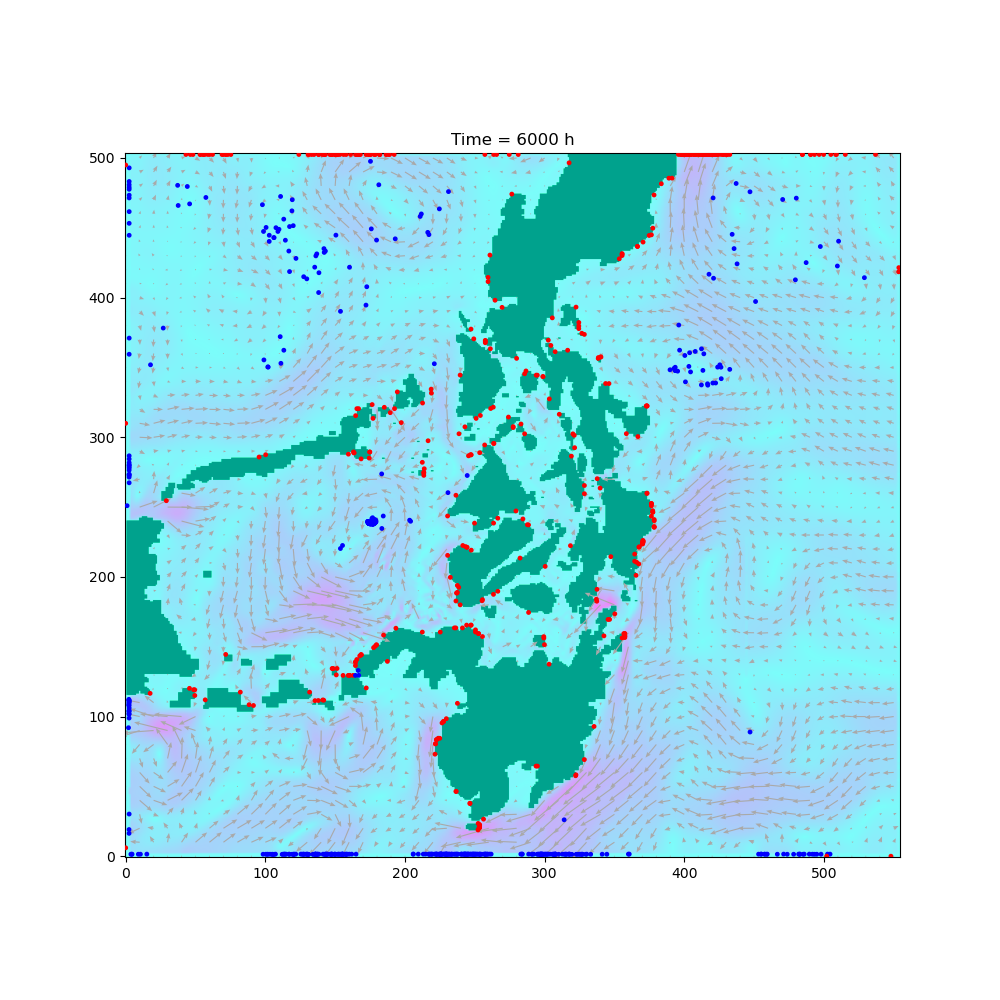

In [65]:
debris_simulator.make_trajectory_plot(6000, trace=0)

After 6000 hours simulation, many particles have arrived on land. The red dots indicate the locations. These could be the possible lactions to set up the monitoring stations. A good location for a monitoring station will be areas where many of such particles land on the coast.